<a href="https://colab.research.google.com/github/Marianicko/skin_lesion_segmentation/blob/master/segm_tr.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Clean cache

In [ ]:
%reset -f
!rm -rf /content/tmp/*
!rm -rf /content/.cache/*

import torch
torch.cuda.empty_cache()

Пробуй пока без следующей ячейки

In [ ]:
# Установка зависимостей
#!pip install torch torchvision torchaudio
#!pip install opencv-python albumentations matplotlib tqdm tensorboard accelerate
#!pip install gitpython  # Для проверки последних коммитов



Продолжай отсюда

In [ ]:
# Клонирование репозитория
import os
if not os.path.exists('skin_lesion_segmentation'):
    !git clone https://github.com/Marianicko/skin_lesion_segmentation.git
else:
    %cd skin_lesion_segmentation
    !git pull
    %cd ..



/content/skin_lesion_segmentation
Already up to date.
/content


In [ ]:
# Проверка последних коммитов (опционально)
from git import Repo
repo = Repo('skin_lesion_segmentation')
print("Последние коммиты:")
for commit in list(repo.iter_commits('master', max_count=3)):
    print(f"{commit.hexsha[:7]} - {commit.message}")



Последние коммиты:
4290524 - Теперь через конфигурационный файл можно включать и выключать предобработку

0131478 - попытка решить проблему с неправильным размером после аугментаций

1ff9ee1 - ---



In [ ]:
import sys
import os
# Правильное добавление пути к модулям
repo_path = '/content/skin_lesion_segmentation'
src_path = os.path.join(repo_path, 'src')
sys.path.insert(0, repo_path)  # Добавляем корень репозитория
sys.path.insert(0, src_path)  # Добавляем папку src

# Проверка содержимого папки src (для отладки)
print("Содержимое папки src:")
print(os.listdir(src_path))

# Проверка путей (для отладки)
print("\nПути поиска модулей:")
for path in sys.path:
    print(path)

Содержимое папки src:
['dd.py', 'preprocess.py', 'metric.py', 'train.py', 'config.py', 'unet.py', 'dataset_upd_1505.py', 'model.py', 'train_new_2005.py', 'test_preprocessing.py', 'preprocess_hb.py', 'visualizations', 'preprocess_spec_2005.py', 'train_2005.py', '__pycache__', 'utils.py', 'checkpoints', 'logs', 'dataset_cur.py', 'checkpointer.py', 'preprocess_spec.py', '.ipynb_checkpoints', 'visualize.ipynb', 'loss.py', 'dataset_upd_2005.py', 'text', 'dataset_upd.py', 'train_old.py']

Пути поиска модулей:
/content/skin_lesion_segmentation/src
/content/skin_lesion_segmentation
/content
/env/python
/usr/lib/python311.zip
/usr/lib/python3.11
/usr/lib/python3.11/lib-dynload

/usr/local/lib/python3.11/dist-packages
/usr/lib/python3/dist-packages
/usr/local/lib/python3.11/dist-packages/IPython/extensions
/usr/local/lib/python3.11/dist-packages/setuptools/_vendor
/root/.ipython


In [ ]:
# Загрузка расширений для TensorBoard
%load_ext tensorboard
%tensorboard --logdir /content/skin_lesion_segmentation/logs --port 6006





Reusing TensorBoard on port 6006 (pid 1138), started 0:02:16 ago. (Use '!kill 1138' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
!pip show torchmetrics

Name: torchmetrics
Version: 1.7.1
Summary: PyTorch native Metrics
Home-page: https://github.com/Lightning-AI/torchmetrics
Author: Lightning-AI et al.
Author-email: name@pytorchlightning.ai
License: Apache-2.0
Location: /usr/local/lib/python3.11/dist-packages
Requires: lightning-utilities, numpy, packaging, torch
Required-by: 


In [ ]:
# Импорт с явным указанием, что это локальные модули
from dataset_upd_2005 import get_datasets
from model import SegmentationModel
from config import Config
from train_new_2005 import train

/usr/local/lib/python3.11/dist-packages/albumentations/__init__.py:28: UserWarning: A new version of Albumentations is available: '2.0.7' (you have '2.0.6'). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()


In [ ]:
# Проверка доступности GPU
import torch
print("Доступен GPU:", torch.cuda.is_available())
Config.DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
print("Устройство для обучения:", Config.DEVICE)



Доступен GPU: True
Устройство для обучения: cuda


Проверяем, что датасет читабелен

In [ ]:
train_ds, val_ds, test_ds = get_datasets(
    images_dir="/content/skin_lesion_segmentation/PH2_Dataset/trainx",
    masks_dir="/content/skin_lesion_segmentation/PH2_Dataset/trainy",
    preprocess=True
)
print("Проверка датасетов:")
print(f"Train: {len(train_ds)} samples")
print(f"Val: {len(val_ds)} samples")
print(f"Test: {len(test_ds)} samples")


Проверка датасетов:
Train: 140 samples
Val: 40 samples
Test: 20 samples


Внимание! Не забудь поменять конфигурационный файл!

In [ ]:
print(Config.IMAGES_DIR)
Config.IMAGES_DIR = "/content/skin_lesion_segmentation/PH2_Dataset/trainx"
Config.MASKS_DIR = "/content/skin_lesion_segmentation/PH2_Dataset/trainy"

./PH2_Dataset/trainx


In [ ]:
from pathlib import Path
import os

# Укажите правильные пути (пример для Colab)
print(Config.BATCH_SIZE)

# Создаём папки, если их нет
Path(Config.IMAGES_DIR).mkdir(parents=True, exist_ok=True)
Path(Config.MASKS_DIR).mkdir(parents=True, exist_ok=True)

# Проверка данных
assert len(os.listdir(Config.IMAGES_DIR)) > 0, "Нет изображений!"
assert len(os.listdir(Config.MASKS_DIR)) > 0, "Нет масок!"
print(f"Найдено {len(os.listdir(Config.IMAGES_DIR))} изображений и {len(os.listdir(Config.MASKS_DIR))} масок")

4
Найдено 200 изображений и 200 масок


Диагностика:

In [ ]:
import os
import sys
from src.dataset_upd_2005 import PHDataset, get_datasets

# 1. Проверим структуру данных
print("\nСодержимое папки с изображениями:")
!ls -la /content/skin_lesion_segmentation/PH2_Dataset/trainx | head -5
print("\nСодержимое папки с масками:")
!ls -la /content/skin_lesion_segmentation/PH2_Dataset/trainy | head -5

# 2. Создадим датасет без разделения
print("\nСоздаём полный датасет для проверки:")
full_dataset = PHDataset(
    images_dir="/content/skin_lesion_segmentation/PH2_Dataset/trainx",
    masks_dir="/content/skin_lesion_segmentation/PH2_Dataset/trainy",
    preprocess=True
)
print(f"Всего элементов: {len(full_dataset)}")

# 3. Проверим первый элемент
try:
    img, mask = full_dataset[0]
    print(f"\nПервый элемент успешно загружен:")
    print(f"Тип изображения: {type(img)}, форма: {img.shape if hasattr(img, 'shape') else 'N/A'}")
    print(f"Тип маски: {type(mask)}, форма: {mask.shape if hasattr(mask, 'shape') else 'N/A'}")
except Exception as e:
    print(f"\nОшибка при загрузке элемента: {str(e)}")

# 4. Проверим разделённые датасеты
print("\nПроверяем разделённые датасеты:")
train_ds, val_ds, test_ds = get_datasets(
    images_dir="/content/skin_lesion_segmentation/PH2_Dataset/trainx",
    masks_dir="/content/skin_lesion_segmentation/PH2_Dataset/trainy",
    preprocess=True,
    crop_borders=True
)

print("\nПробуем получить первый элемент из train:")
try:
    img, mask = train_ds[0]
    print("Успешно!")
except Exception as e:
    print(f"Ошибка: {str(e)}")
    print("\nДополнительная диагностика:")
    print(f"Тип train_ds: {type(train_ds)}")
    print(f"Длина train_ds: {len(train_ds)}")
    print(f"Индексы train_ds: {train_ds.indices[:5] if hasattr(train_ds, 'indices') else 'N/A'}")
    print(f"Dataset train_ds: {train_ds.dataset if hasattr(train_ds, 'dataset') else 'N/A'}")

# 5. Проверим DataLoader
print("\nПроверяем DataLoader:")
from torch.utils.data import DataLoader
try:
    loader = DataLoader(train_ds, batch_size=2)
    batch = next(iter(loader))
    print("DataLoader работает! Формы:")
    print(f"Изображения: {batch[0].shape}")
    print(f"Маски: {batch[1].shape}")
except Exception as e:
    print(f"Ошибка в DataLoader: {str(e)}")


Содержимое папки с изображениями:
total 259160
drwxr-xr-x 2 root root    4096 May 21 14:11 .
drwxr-xr-x 4 root root    4096 May 21 14:11 ..
-rw-r--r-- 1 root root 1313366 May 21 14:11 IMD002.bmp
-rw-r--r-- 1 root root 1317958 May 21 14:11 IMD003.bmp

Содержимое папки с масками:
total 11092
drwxr-xr-x 2 root root 12288 May 21 14:11 .
drwxr-xr-x 4 root root  4096 May 21 14:11 ..
-rw-r--r-- 1 root root 54974 May 21 14:11 IMD002_lesion.bmp
-rw-r--r-- 1 root root 55166 May 21 14:11 IMD003_lesion.bmp

Создаём полный датасет для проверки:
Всего элементов: 200

Первый элемент успешно загружен:
Тип изображения: <class 'numpy.ndarray'>, форма: (512, 512, 3)
Тип маски: <class 'numpy.ndarray'>, форма: (512, 512)

Проверяем разделённые датасеты:

Пробуем получить первый элемент из train:
Успешно!

Проверяем DataLoader:
DataLoader работает! Формы:
Изображения: torch.Size([2, 3, 512, 512])
Маски: torch.Size([2, 512, 512])


Диагностика показала проблему, связанную с попыткой применить к маске предобработку, предназначенную для цветного изображения. Уже решила её

In [ ]:
from dataset_upd_2005 import get_datasets
from preprocess_spec_2005 import DermatologyPreprocessor
from train_new_2005 import train

Пока уменьшим число эпох, чтобы посмотреть на конец обучения


In [ ]:
Config.EPOCHS = 50
print(Config.EPOCHS)

50


Через конфигурационный файл можем управлять включением/выключением предобработки

In [ ]:
Config.PREPROCESS_FLAG = False

Теперь наша задача - сохранить результаты обучения на предобработанных и сырых данных


=== Проверка данных ===
Размер изображения: torch.Size([3, 512, 512])
Размер маски: torch.Size([512, 512])

Train Sample:


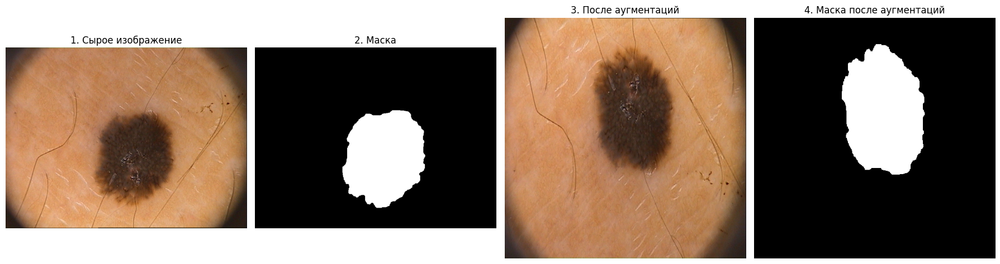

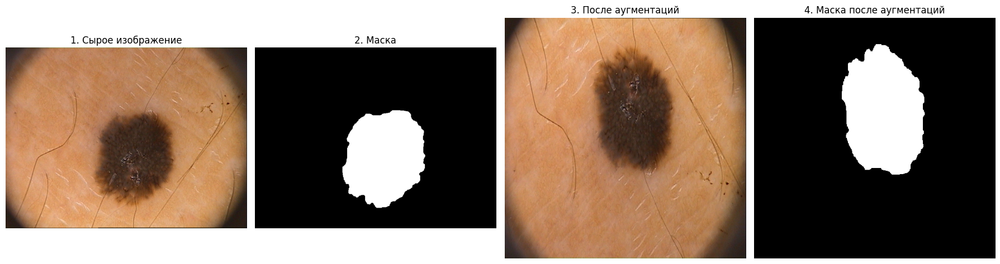

Epoch 1: 100%|██████████| 40/40 [00:14<00:00,  2.67it/s]


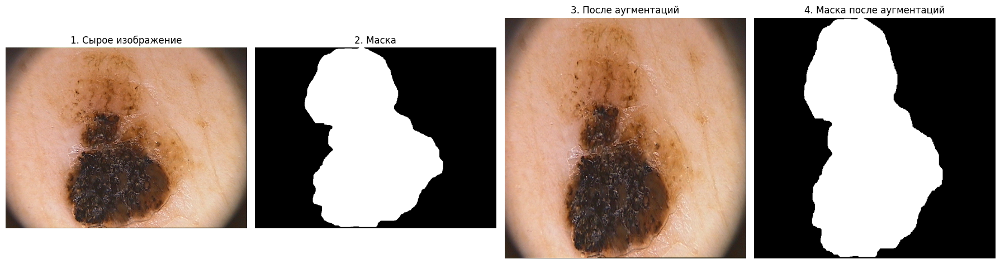

Saving checkpoint (val_iou ==  0.732914388179779
Попытка сохранения чекпоинта. Метрика: 0.732914388179779, epoch: 0
Путь для сохранения: checkpoints/model_e000_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.7329 on 1 epoch
Epoch 2: 100%|██████████| 40/40 [00:15<00:00,  2.63it/s]


Saving checkpoint (val_iou ==  0.7449164390563965
Попытка сохранения чекпоинта. Метрика: 0.7449164390563965, epoch: 1
Путь для сохранения: checkpoints/model_e001_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.7449 on 2 epoch
Epoch 3: 100%|██████████| 40/40 [00:15<00:00,  2.58it/s]


Saving checkpoint (val_iou ==  0.7525051832199097
Попытка сохранения чекпоинта. Метрика: 0.7525051832199097, epoch: 2
Путь для сохранения: checkpoints/model_e002_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.7525 on 3 epoch
Epoch 4: 100%|██████████| 40/40 [00:15<00:00,  2.51it/s]


Saving checkpoint (val_iou ==  0.7951400279998779
Попытка сохранения чекпоинта. Метрика: 0.7951400279998779, epoch: 3
Путь для сохранения: checkpoints/model_e003_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.7951 on 4 epoch
Epoch 5: 100%|██████████| 40/40 [00:16<00:00,  2.47it/s]


Saving checkpoint (val_iou ==  0.7632551789283752
Попытка сохранения чекпоинта. Метрика: 0.7632551789283752, epoch: 4
Путь для сохранения: checkpoints/model_e004_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.7951 on 4 epoch
Epoch 6: 100%|██████████| 40/40 [00:15<00:00,  2.53it/s]


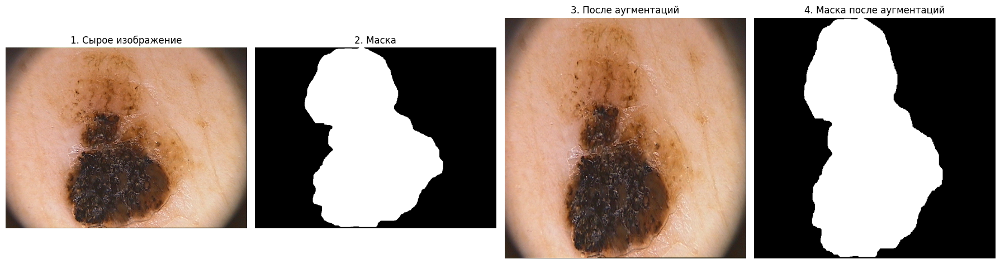

Saving checkpoint (val_iou ==  0.7024294137954712
Попытка сохранения чекпоинта. Метрика: 0.7024294137954712, epoch: 5
Путь для сохранения: checkpoints/model_e005_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.7951 on 4 epoch
Epoch 7: 100%|██████████| 40/40 [00:15<00:00,  2.57it/s]


Saving checkpoint (val_iou ==  0.7832559943199158
Попытка сохранения чекпоинта. Метрика: 0.7832559943199158, epoch: 6
Путь для сохранения: checkpoints/model_e006_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.7951 on 4 epoch
Epoch 8: 100%|██████████| 40/40 [00:15<00:00,  2.54it/s]


Saving checkpoint (val_iou ==  0.7958070039749146
Попытка сохранения чекпоинта. Метрика: 0.7958070039749146, epoch: 7
Путь для сохранения: checkpoints/model_e007_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.7958 on 8 epoch
Epoch 9: 100%|██████████| 40/40 [00:15<00:00,  2.52it/s]


Saving checkpoint (val_iou ==  0.8346624970436096
Попытка сохранения чекпоинта. Метрика: 0.8346624970436096, epoch: 8
Путь для сохранения: checkpoints/model_e008_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8347 on 9 epoch
Epoch 10: 100%|██████████| 40/40 [00:15<00:00,  2.51it/s]


Saving checkpoint (val_iou ==  0.8156408071517944
Попытка сохранения чекпоинта. Метрика: 0.8156408071517944, epoch: 9
Путь для сохранения: checkpoints/model_e009_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8347 on 9 epoch
Epoch 11: 100%|██████████| 40/40 [00:15<00:00,  2.54it/s]


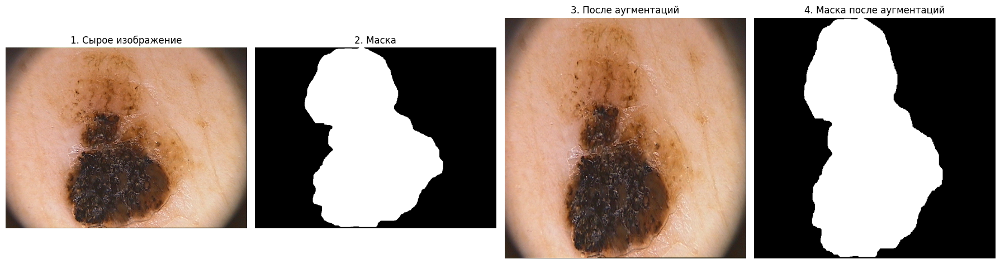

Saving checkpoint (val_iou ==  0.7826128005981445
Попытка сохранения чекпоинта. Метрика: 0.7826128005981445, epoch: 10
Путь для сохранения: checkpoints/model_e010_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8347 on 9 epoch
Epoch 12: 100%|██████████| 40/40 [00:15<00:00,  2.56it/s]
INFO:checkpointer:Best epoch MeanIoU value is 0.8347 on 9 epoch


Saving checkpoint (val_iou ==  0.8258179426193237
Попытка сохранения чекпоинта. Метрика: 0.8258179426193237, epoch: 11
Путь для сохранения: checkpoints/model_e011_checkpoint.pt


Epoch 13: 100%|██████████| 40/40 [00:15<00:00,  2.51it/s]
INFO:checkpointer:Best epoch MeanIoU value is 0.8347 on 9 epoch


Saving checkpoint (val_iou ==  0.8320192098617554
Попытка сохранения чекпоинта. Метрика: 0.8320192098617554, epoch: 12
Путь для сохранения: checkpoints/model_e012_checkpoint.pt


Epoch 14: 100%|██████████| 40/40 [00:15<00:00,  2.52it/s]


Saving checkpoint (val_iou ==  0.8441345691680908
Попытка сохранения чекпоинта. Метрика: 0.8441345691680908, epoch: 13
Путь для сохранения: checkpoints/model_e013_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8441 on 14 epoch
Epoch 15: 100%|██████████| 40/40 [00:15<00:00,  2.52it/s]


Saving checkpoint (val_iou ==  0.8427778482437134
Попытка сохранения чекпоинта. Метрика: 0.8427778482437134, epoch: 14
Путь для сохранения: checkpoints/model_e014_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8441 on 14 epoch
Epoch 16: 100%|██████████| 40/40 [00:15<00:00,  2.52it/s]


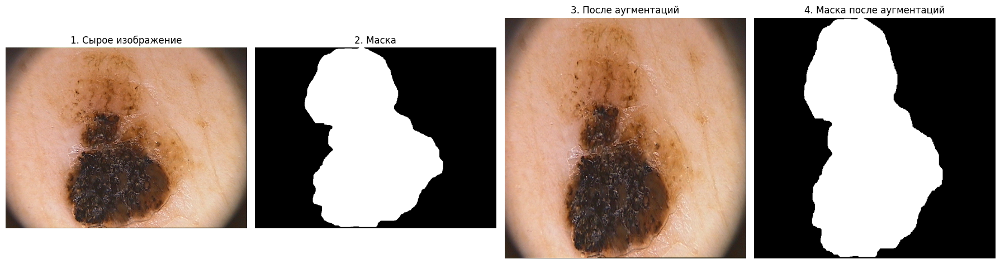

Saving checkpoint (val_iou ==  0.8155884742736816
Попытка сохранения чекпоинта. Метрика: 0.8155884742736816, epoch: 15
Путь для сохранения: checkpoints/model_e015_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8441 on 14 epoch
Epoch 17: 100%|██████████| 40/40 [00:15<00:00,  2.54it/s]
INFO:checkpointer:Best epoch MeanIoU value is 0.8441 on 14 epoch


Saving checkpoint (val_iou ==  0.8129398226737976
Попытка сохранения чекпоинта. Метрика: 0.8129398226737976, epoch: 16
Путь для сохранения: checkpoints/model_e016_checkpoint.pt


Epoch 18: 100%|██████████| 40/40 [00:15<00:00,  2.52it/s]


Saving checkpoint (val_iou ==  0.8231604099273682
Попытка сохранения чекпоинта. Метрика: 0.8231604099273682, epoch: 17
Путь для сохранения: checkpoints/model_e017_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8441 on 14 epoch
Epoch 19: 100%|██████████| 40/40 [00:15<00:00,  2.54it/s]


Saving checkpoint (val_iou ==  0.8369961977005005
Попытка сохранения чекпоинта. Метрика: 0.8369961977005005, epoch: 18
Путь для сохранения: checkpoints/model_e018_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8441 on 14 epoch
Epoch 20: 100%|██████████| 40/40 [00:15<00:00,  2.52it/s]
INFO:checkpointer:Best epoch MeanIoU value is 0.8441 on 14 epoch


Saving checkpoint (val_iou ==  0.8422322273254395
Попытка сохранения чекпоинта. Метрика: 0.8422322273254395, epoch: 19
Путь для сохранения: checkpoints/model_e019_checkpoint.pt


Epoch 21: 100%|██████████| 40/40 [00:15<00:00,  2.52it/s]


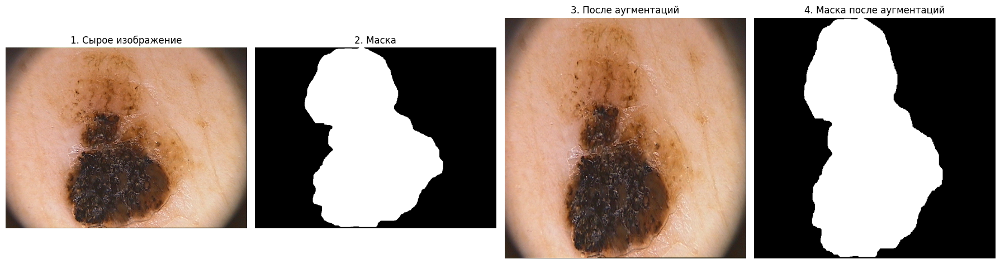

Saving checkpoint (val_iou ==  0.8362476825714111
Попытка сохранения чекпоинта. Метрика: 0.8362476825714111, epoch: 20
Путь для сохранения: checkpoints/model_e020_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8441 on 14 epoch
Epoch 22: 100%|██████████| 40/40 [00:15<00:00,  2.53it/s]


Saving checkpoint (val_iou ==  0.7970281839370728
Попытка сохранения чекпоинта. Метрика: 0.7970281839370728, epoch: 21
Путь для сохранения: checkpoints/model_e021_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8441 on 14 epoch
Epoch 23: 100%|██████████| 40/40 [00:15<00:00,  2.53it/s]


Saving checkpoint (val_iou ==  0.8431007266044617
Попытка сохранения чекпоинта. Метрика: 0.8431007266044617, epoch: 22
Путь для сохранения: checkpoints/model_e022_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8441 on 14 epoch
Epoch 24: 100%|██████████| 40/40 [00:16<00:00,  2.50it/s]


Saving checkpoint (val_iou ==  0.8268636465072632
Попытка сохранения чекпоинта. Метрика: 0.8268636465072632, epoch: 23
Путь для сохранения: checkpoints/model_e023_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8441 on 14 epoch
Epoch 25: 100%|██████████| 40/40 [00:15<00:00,  2.51it/s]


Saving checkpoint (val_iou ==  0.8474915027618408
Попытка сохранения чекпоинта. Метрика: 0.8474915027618408, epoch: 24
Путь для сохранения: checkpoints/model_e024_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8475 on 25 epoch
Epoch 26: 100%|██████████| 40/40 [00:15<00:00,  2.52it/s]


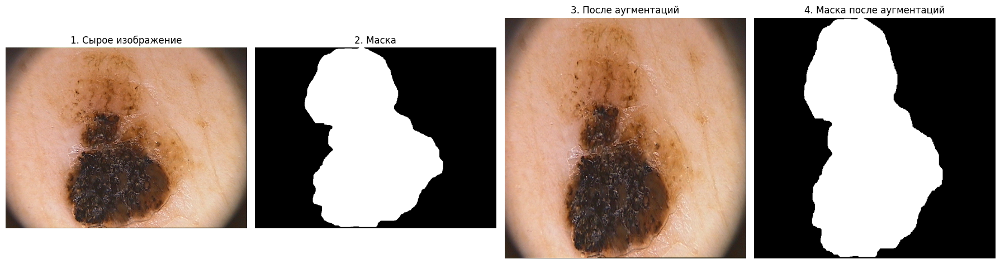

Saving checkpoint (val_iou ==  0.8376316428184509
Попытка сохранения чекпоинта. Метрика: 0.8376316428184509, epoch: 25
Путь для сохранения: checkpoints/model_e025_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8475 on 25 epoch
Epoch 27: 100%|██████████| 40/40 [00:15<00:00,  2.53it/s]


Saving checkpoint (val_iou ==  0.8557500839233398
Попытка сохранения чекпоинта. Метрика: 0.8557500839233398, epoch: 26
Путь для сохранения: checkpoints/model_e026_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8558 on 27 epoch
Epoch 28: 100%|██████████| 40/40 [00:15<00:00,  2.52it/s]


Saving checkpoint (val_iou ==  0.7929480075836182
Попытка сохранения чекпоинта. Метрика: 0.7929480075836182, epoch: 27
Путь для сохранения: checkpoints/model_e027_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8558 on 27 epoch
Epoch 29: 100%|██████████| 40/40 [00:15<00:00,  2.50it/s]


Saving checkpoint (val_iou ==  0.8680131435394287
Попытка сохранения чекпоинта. Метрика: 0.8680131435394287, epoch: 28
Путь для сохранения: checkpoints/model_e028_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8680 on 29 epoch
Epoch 30: 100%|██████████| 40/40 [00:15<00:00,  2.51it/s]


Saving checkpoint (val_iou ==  0.8358726501464844
Попытка сохранения чекпоинта. Метрика: 0.8358726501464844, epoch: 29
Путь для сохранения: checkpoints/model_e029_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8680 on 29 epoch
Epoch 31: 100%|██████████| 40/40 [00:15<00:00,  2.51it/s]


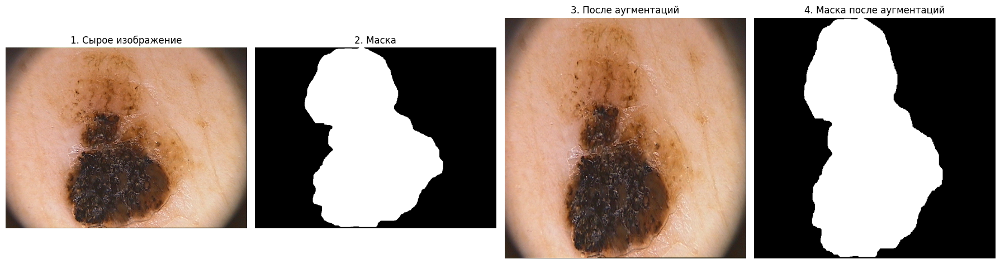

Saving checkpoint (val_iou ==  0.7907036542892456
Попытка сохранения чекпоинта. Метрика: 0.7907036542892456, epoch: 30
Путь для сохранения: checkpoints/model_e030_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8680 on 29 epoch
Epoch 32: 100%|██████████| 40/40 [00:15<00:00,  2.53it/s]


Saving checkpoint (val_iou ==  0.841533899307251
Попытка сохранения чекпоинта. Метрика: 0.841533899307251, epoch: 31
Путь для сохранения: checkpoints/model_e031_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8680 on 29 epoch
Epoch 33: 100%|██████████| 40/40 [00:15<00:00,  2.52it/s]


Saving checkpoint (val_iou ==  0.8663285374641418
Попытка сохранения чекпоинта. Метрика: 0.8663285374641418, epoch: 32
Путь для сохранения: checkpoints/model_e032_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8680 on 29 epoch
Epoch 34: 100%|██████████| 40/40 [00:15<00:00,  2.51it/s]


Saving checkpoint (val_iou ==  0.8409007787704468
Попытка сохранения чекпоинта. Метрика: 0.8409007787704468, epoch: 33
Путь для сохранения: checkpoints/model_e033_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8680 on 29 epoch
Epoch 35: 100%|██████████| 40/40 [00:15<00:00,  2.53it/s]


Saving checkpoint (val_iou ==  0.8577554225921631
Попытка сохранения чекпоинта. Метрика: 0.8577554225921631, epoch: 34
Путь для сохранения: checkpoints/model_e034_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8680 on 29 epoch
Epoch 36: 100%|██████████| 40/40 [00:15<00:00,  2.54it/s]


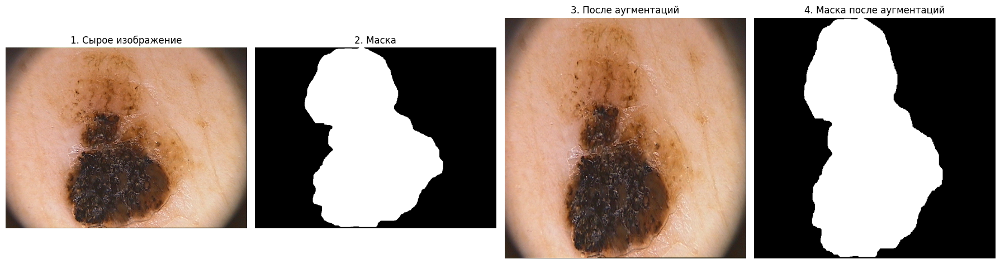

Saving checkpoint (val_iou ==  0.8339331150054932
Попытка сохранения чекпоинта. Метрика: 0.8339331150054932, epoch: 35
Путь для сохранения: checkpoints/model_e035_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8680 on 29 epoch
Epoch 37: 100%|██████████| 40/40 [00:15<00:00,  2.52it/s]


Saving checkpoint (val_iou ==  0.8451234102249146
Попытка сохранения чекпоинта. Метрика: 0.8451234102249146, epoch: 36
Путь для сохранения: checkpoints/model_e036_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8680 on 29 epoch
Epoch 38: 100%|██████████| 40/40 [00:15<00:00,  2.52it/s]


Saving checkpoint (val_iou ==  0.8692963719367981
Попытка сохранения чекпоинта. Метрика: 0.8692963719367981, epoch: 37
Путь для сохранения: checkpoints/model_e037_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8693 on 38 epoch
Epoch 39: 100%|██████████| 40/40 [00:16<00:00,  2.49it/s]


Saving checkpoint (val_iou ==  0.8547191619873047
Попытка сохранения чекпоинта. Метрика: 0.8547191619873047, epoch: 38
Путь для сохранения: checkpoints/model_e038_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8693 on 38 epoch
Epoch 40: 100%|██████████| 40/40 [00:15<00:00,  2.52it/s]


Saving checkpoint (val_iou ==  0.882771372795105
Попытка сохранения чекпоинта. Метрика: 0.882771372795105, epoch: 39
Путь для сохранения: checkpoints/model_e039_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8828 on 40 epoch
Epoch 41: 100%|██████████| 40/40 [00:15<00:00,  2.53it/s]


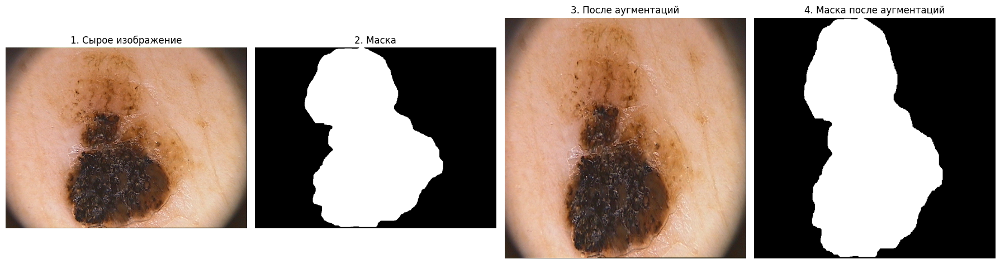

Saving checkpoint (val_iou ==  0.8608213663101196
Попытка сохранения чекпоинта. Метрика: 0.8608213663101196, epoch: 40
Путь для сохранения: checkpoints/model_e040_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8828 on 40 epoch
Epoch 42: 100%|██████████| 40/40 [00:16<00:00,  2.49it/s]


Saving checkpoint (val_iou ==  0.824946403503418
Попытка сохранения чекпоинта. Метрика: 0.824946403503418, epoch: 41
Путь для сохранения: checkpoints/model_e041_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8828 on 40 epoch
Epoch 43: 100%|██████████| 40/40 [00:16<00:00,  2.50it/s]


Saving checkpoint (val_iou ==  0.8530985116958618
Попытка сохранения чекпоинта. Метрика: 0.8530985116958618, epoch: 42
Путь для сохранения: checkpoints/model_e042_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8828 on 40 epoch
Epoch 44: 100%|██████████| 40/40 [00:16<00:00,  2.49it/s]


Saving checkpoint (val_iou ==  0.8594065308570862
Попытка сохранения чекпоинта. Метрика: 0.8594065308570862, epoch: 43
Путь для сохранения: checkpoints/model_e043_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8828 on 40 epoch
Epoch 45: 100%|██████████| 40/40 [00:15<00:00,  2.53it/s]


Saving checkpoint (val_iou ==  0.8764730095863342
Попытка сохранения чекпоинта. Метрика: 0.8764730095863342, epoch: 44
Путь для сохранения: checkpoints/model_e044_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8828 on 40 epoch
Epoch 46: 100%|██████████| 40/40 [00:15<00:00,  2.53it/s]


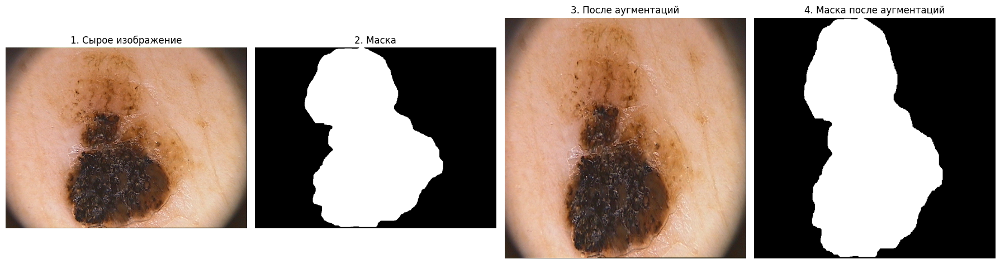

Saving checkpoint (val_iou ==  0.8355974555015564


INFO:checkpointer:Best epoch MeanIoU value is 0.8828 on 40 epoch


Попытка сохранения чекпоинта. Метрика: 0.8355974555015564, epoch: 45
Путь для сохранения: checkpoints/model_e045_checkpoint.pt


Epoch 47: 100%|██████████| 40/40 [00:16<00:00,  2.50it/s]


Saving checkpoint (val_iou ==  0.8681465983390808
Попытка сохранения чекпоинта. Метрика: 0.8681465983390808, epoch: 46
Путь для сохранения: checkpoints/model_e046_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8828 on 40 epoch
Epoch 48: 100%|██████████| 40/40 [00:15<00:00,  2.51it/s]


Saving checkpoint (val_iou ==  0.8801525235176086
Попытка сохранения чекпоинта. Метрика: 0.8801525235176086, epoch: 47
Путь для сохранения: checkpoints/model_e047_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8828 on 40 epoch
Epoch 49: 100%|██████████| 40/40 [00:15<00:00,  2.51it/s]


Saving checkpoint (val_iou ==  0.8424089550971985
Попытка сохранения чекпоинта. Метрика: 0.8424089550971985, epoch: 48
Путь для сохранения: checkpoints/model_e048_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8828 on 40 epoch
Epoch 50: 100%|██████████| 40/40 [00:15<00:00,  2.50it/s]


Saving checkpoint (val_iou ==  0.8739579916000366
Попытка сохранения чекпоинта. Метрика: 0.8739579916000366, epoch: 49
Путь для сохранения: checkpoints/model_e049_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8828 on 40 epoch


Обучение завершено успешно!


In [ ]:
train()

Не вижу выводов по сохранению (уже поправила)

Теперь надо посмотреть, как модель справляется с тестами - как это сделать? И нужно поправить

А пока обучим модель на предобработанных данных

In [ ]:
Config.PREPROCESS_FLAG = True
print(Config.EPOCHS)

50



=== Проверка данных ===
Размер изображения: torch.Size([3, 512, 512])
Размер маски: torch.Size([512, 512])

Train Sample:


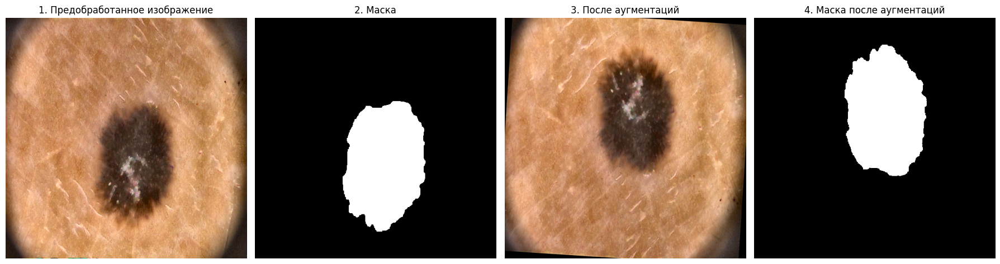

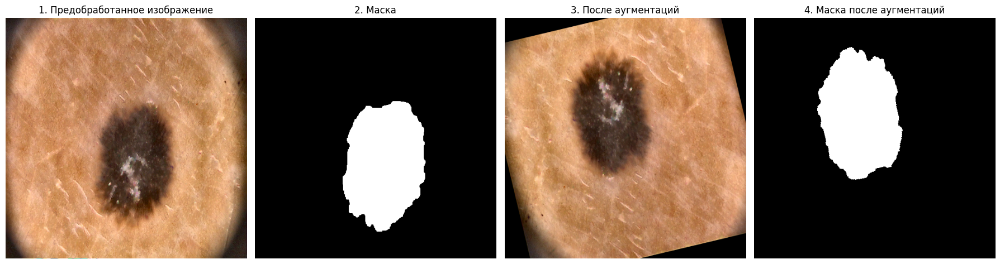

Epoch 1: 100%|██████████| 40/40 [02:13<00:00,  3.34s/it]


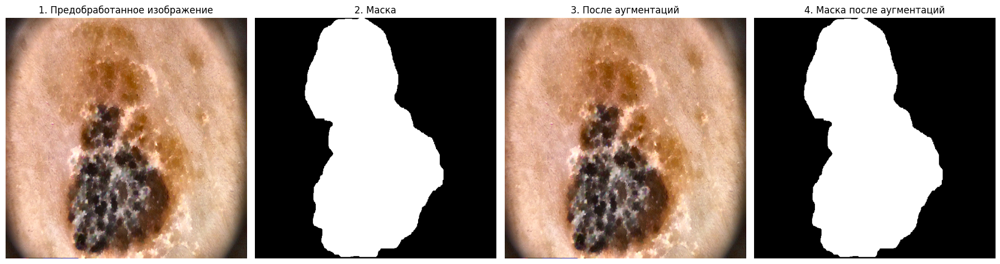

Saving checkpoint (val_iou ==  0.7620667219161987
Попытка сохранения чекпоинта. Метрика: 0.7620667219161987, epoch: 0
Путь для сохранения: checkpoints/model_e000_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.7621 on 1 epoch
Epoch 2: 100%|██████████| 40/40 [02:14<00:00,  3.35s/it]


Saving checkpoint (val_iou ==  0.810175895690918
Попытка сохранения чекпоинта. Метрика: 0.810175895690918, epoch: 1
Путь для сохранения: checkpoints/model_e001_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8102 on 2 epoch
Epoch 3: 100%|██████████| 40/40 [02:14<00:00,  3.36s/it]


Saving checkpoint (val_iou ==  0.7439746260643005
Попытка сохранения чекпоинта. Метрика: 0.7439746260643005, epoch: 2
Путь для сохранения: checkpoints/model_e002_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8102 on 2 epoch
Epoch 4: 100%|██████████| 40/40 [02:13<00:00,  3.35s/it]


Saving checkpoint (val_iou ==  0.7383534908294678
Попытка сохранения чекпоинта. Метрика: 0.7383534908294678, epoch: 3
Путь для сохранения: checkpoints/model_e003_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8102 on 2 epoch
Epoch 5: 100%|██████████| 40/40 [02:13<00:00,  3.35s/it]


Saving checkpoint (val_iou ==  0.834831953048706
Попытка сохранения чекпоинта. Метрика: 0.834831953048706, epoch: 4
Путь для сохранения: checkpoints/model_e004_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8348 on 5 epoch
Epoch 6: 100%|██████████| 40/40 [02:14<00:00,  3.36s/it]


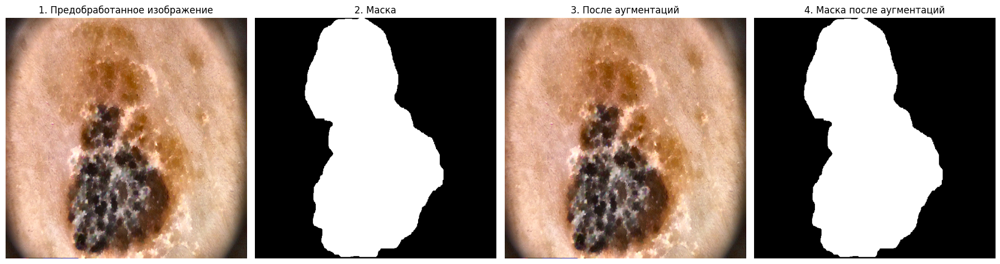

Saving checkpoint (val_iou ==  0.7739752531051636
Попытка сохранения чекпоинта. Метрика: 0.7739752531051636, epoch: 5
Путь для сохранения: checkpoints/model_e005_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8348 on 5 epoch
Epoch 7: 100%|██████████| 40/40 [02:13<00:00,  3.33s/it]


Saving checkpoint (val_iou ==  0.8392528295516968
Попытка сохранения чекпоинта. Метрика: 0.8392528295516968, epoch: 6
Путь для сохранения: checkpoints/model_e006_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8393 on 7 epoch
Epoch 8: 100%|██████████| 40/40 [02:14<00:00,  3.37s/it]


Saving checkpoint (val_iou ==  0.8227609395980835
Попытка сохранения чекпоинта. Метрика: 0.8227609395980835, epoch: 7
Путь для сохранения: checkpoints/model_e007_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8393 on 7 epoch
Epoch 9: 100%|██████████| 40/40 [02:14<00:00,  3.35s/it]


Saving checkpoint (val_iou ==  0.8291215300559998
Попытка сохранения чекпоинта. Метрика: 0.8291215300559998, epoch: 8
Путь для сохранения: checkpoints/model_e008_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8393 on 7 epoch
Epoch 10: 100%|██████████| 40/40 [02:14<00:00,  3.36s/it]


Saving checkpoint (val_iou ==  0.8184601068496704
Попытка сохранения чекпоинта. Метрика: 0.8184601068496704, epoch: 9
Путь для сохранения: checkpoints/model_e009_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8393 on 7 epoch
Epoch 11: 100%|██████████| 40/40 [02:14<00:00,  3.36s/it]


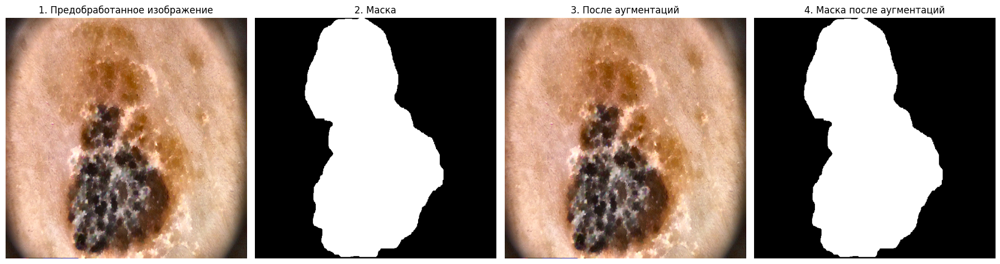

Saving checkpoint (val_iou ==  0.832883358001709


INFO:checkpointer:Best epoch MeanIoU value is 0.8393 on 7 epoch


Попытка сохранения чекпоинта. Метрика: 0.832883358001709, epoch: 10
Путь для сохранения: checkpoints/model_e010_checkpoint.pt


Epoch 12: 100%|██████████| 40/40 [02:14<00:00,  3.37s/it]


Saving checkpoint (val_iou ==  0.8328430652618408
Попытка сохранения чекпоинта. Метрика: 0.8328430652618408, epoch: 11
Путь для сохранения: checkpoints/model_e011_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8393 on 7 epoch
Epoch 13: 100%|██████████| 40/40 [02:14<00:00,  3.36s/it]


Saving checkpoint (val_iou ==  0.8164103627204895
Попытка сохранения чекпоинта. Метрика: 0.8164103627204895, epoch: 12
Путь для сохранения: checkpoints/model_e012_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8393 on 7 epoch
Epoch 14: 100%|██████████| 40/40 [02:14<00:00,  3.36s/it]


Saving checkpoint (val_iou ==  0.8279687166213989
Попытка сохранения чекпоинта. Метрика: 0.8279687166213989, epoch: 13
Путь для сохранения: checkpoints/model_e013_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8393 on 7 epoch
Epoch 15: 100%|██████████| 40/40 [02:15<00:00,  3.38s/it]


Saving checkpoint (val_iou ==  0.8498860597610474
Попытка сохранения чекпоинта. Метрика: 0.8498860597610474, epoch: 14
Путь для сохранения: checkpoints/model_e014_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8499 on 15 epoch
Epoch 16: 100%|██████████| 40/40 [02:14<00:00,  3.36s/it]


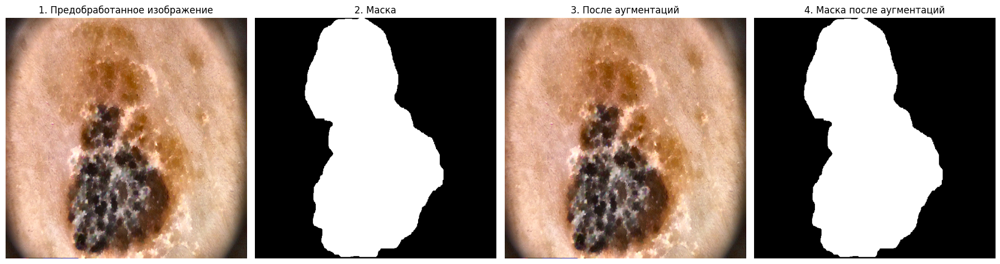

Saving checkpoint (val_iou ==  0.8429232835769653
Попытка сохранения чекпоинта. Метрика: 0.8429232835769653, epoch: 15
Путь для сохранения: checkpoints/model_e015_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8499 on 15 epoch
Epoch 17: 100%|██████████| 40/40 [02:13<00:00,  3.35s/it]


Saving checkpoint (val_iou ==  0.8382441997528076
Попытка сохранения чекпоинта. Метрика: 0.8382441997528076, epoch: 16
Путь для сохранения: checkpoints/model_e016_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8499 on 15 epoch
Epoch 18: 100%|██████████| 40/40 [02:13<00:00,  3.33s/it]


Saving checkpoint (val_iou ==  0.8350189924240112
Попытка сохранения чекпоинта. Метрика: 0.8350189924240112, epoch: 17
Путь для сохранения: checkpoints/model_e017_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8499 on 15 epoch
Epoch 19: 100%|██████████| 40/40 [02:13<00:00,  3.34s/it]


Saving checkpoint (val_iou ==  0.7857741117477417
Попытка сохранения чекпоинта. Метрика: 0.7857741117477417, epoch: 18
Путь для сохранения: checkpoints/model_e018_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8499 on 15 epoch
Epoch 20: 100%|██████████| 40/40 [02:13<00:00,  3.34s/it]


Saving checkpoint (val_iou ==  0.8288284540176392
Попытка сохранения чекпоинта. Метрика: 0.8288284540176392, epoch: 19
Путь для сохранения: checkpoints/model_e019_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8499 on 15 epoch
Epoch 21: 100%|██████████| 40/40 [02:13<00:00,  3.34s/it]


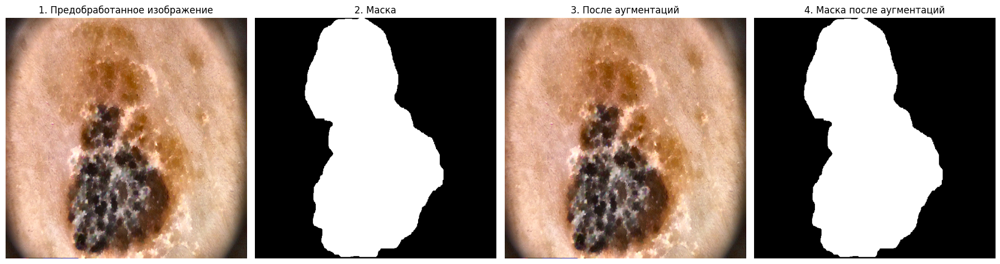

Saving checkpoint (val_iou ==  0.8506595492362976
Попытка сохранения чекпоинта. Метрика: 0.8506595492362976, epoch: 20
Путь для сохранения: checkpoints/model_e020_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8507 on 21 epoch
Epoch 22: 100%|██████████| 40/40 [02:13<00:00,  3.34s/it]


Saving checkpoint (val_iou ==  0.8469946384429932
Попытка сохранения чекпоинта. Метрика: 0.8469946384429932, epoch: 21
Путь для сохранения: checkpoints/model_e021_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8507 on 21 epoch
Epoch 23: 100%|██████████| 40/40 [02:13<00:00,  3.35s/it]


Saving checkpoint (val_iou ==  0.8427993059158325
Попытка сохранения чекпоинта. Метрика: 0.8427993059158325, epoch: 22
Путь для сохранения: checkpoints/model_e022_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8507 on 21 epoch
Epoch 24: 100%|██████████| 40/40 [02:13<00:00,  3.35s/it]


Saving checkpoint (val_iou ==  0.8513296842575073
Попытка сохранения чекпоинта. Метрика: 0.8513296842575073, epoch: 23
Путь для сохранения: checkpoints/model_e023_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8513 on 24 epoch
Epoch 25: 100%|██████████| 40/40 [02:13<00:00,  3.34s/it]


Saving checkpoint (val_iou ==  0.8378266096115112
Попытка сохранения чекпоинта. Метрика: 0.8378266096115112, epoch: 24
Путь для сохранения: checkpoints/model_e024_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8513 on 24 epoch
Epoch 26: 100%|██████████| 40/40 [02:14<00:00,  3.36s/it]


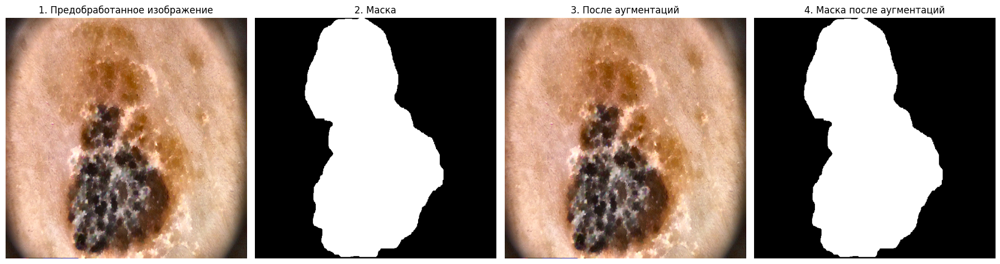

Saving checkpoint (val_iou ==  0.8409581184387207
Попытка сохранения чекпоинта. Метрика: 0.8409581184387207, epoch: 25
Путь для сохранения: checkpoints/model_e025_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8513 on 24 epoch
Epoch 27: 100%|██████████| 40/40 [02:13<00:00,  3.33s/it]


Saving checkpoint (val_iou ==  0.8631570339202881
Попытка сохранения чекпоинта. Метрика: 0.8631570339202881, epoch: 26
Путь для сохранения: checkpoints/model_e026_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8632 on 27 epoch
Epoch 28: 100%|██████████| 40/40 [02:13<00:00,  3.33s/it]


Saving checkpoint (val_iou ==  0.8474729657173157
Попытка сохранения чекпоинта. Метрика: 0.8474729657173157, epoch: 27
Путь для сохранения: checkpoints/model_e027_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8632 on 27 epoch
Epoch 29: 100%|██████████| 40/40 [02:12<00:00,  3.32s/it]


Saving checkpoint (val_iou ==  0.8493030667304993
Попытка сохранения чекпоинта. Метрика: 0.8493030667304993, epoch: 28
Путь для сохранения: checkpoints/model_e028_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8632 on 27 epoch
Epoch 30: 100%|██████████| 40/40 [02:13<00:00,  3.34s/it]


Saving checkpoint (val_iou ==  0.8476767539978027
Попытка сохранения чекпоинта. Метрика: 0.8476767539978027, epoch: 29
Путь для сохранения: checkpoints/model_e029_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8632 on 27 epoch
Epoch 31: 100%|██████████| 40/40 [02:13<00:00,  3.34s/it]


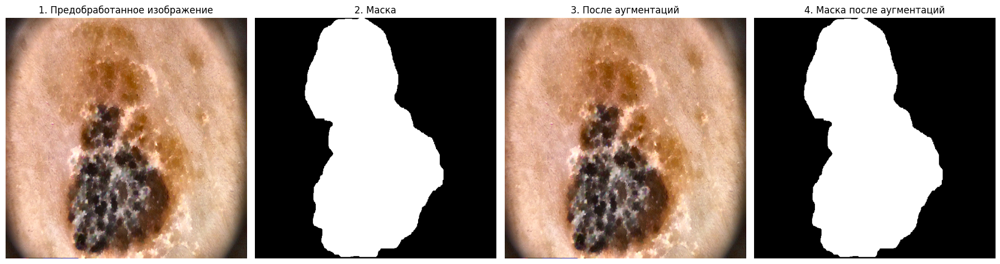

Saving checkpoint (val_iou ==  0.8589528799057007
Попытка сохранения чекпоинта. Метрика: 0.8589528799057007, epoch: 30
Путь для сохранения: checkpoints/model_e030_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8632 on 27 epoch
Epoch 32: 100%|██████████| 40/40 [02:12<00:00,  3.32s/it]


Saving checkpoint (val_iou ==  0.8482121229171753
Попытка сохранения чекпоинта. Метрика: 0.8482121229171753, epoch: 31
Путь для сохранения: checkpoints/model_e031_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8632 on 27 epoch
Epoch 33: 100%|██████████| 40/40 [02:13<00:00,  3.35s/it]


Saving checkpoint (val_iou ==  0.864549994468689
Попытка сохранения чекпоинта. Метрика: 0.864549994468689, epoch: 32
Путь для сохранения: checkpoints/model_e032_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8645 on 33 epoch
Epoch 34: 100%|██████████| 40/40 [02:13<00:00,  3.33s/it]


Saving checkpoint (val_iou ==  0.8052061200141907
Попытка сохранения чекпоинта. Метрика: 0.8052061200141907, epoch: 33
Путь для сохранения: checkpoints/model_e033_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8645 on 33 epoch
Epoch 35: 100%|██████████| 40/40 [02:13<00:00,  3.34s/it]


Saving checkpoint (val_iou ==  0.8486620783805847
Попытка сохранения чекпоинта. Метрика: 0.8486620783805847, epoch: 34
Путь для сохранения: checkpoints/model_e034_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8645 on 33 epoch
Epoch 36: 100%|██████████| 40/40 [02:13<00:00,  3.33s/it]


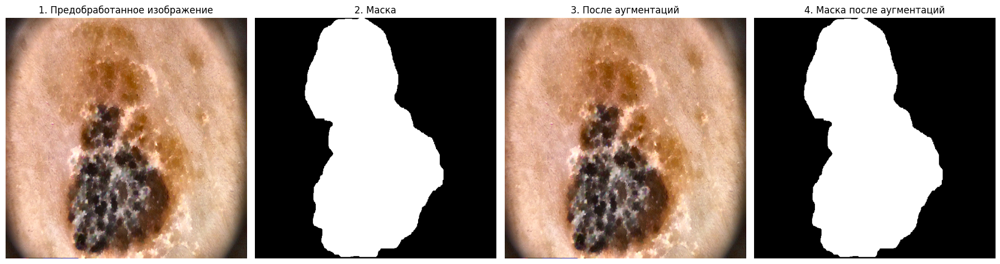

Saving checkpoint (val_iou ==  0.8242400884628296
Попытка сохранения чекпоинта. Метрика: 0.8242400884628296, epoch: 35
Путь для сохранения: checkpoints/model_e035_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8645 on 33 epoch
Epoch 37: 100%|██████████| 40/40 [02:13<00:00,  3.34s/it]


Saving checkpoint (val_iou ==  0.8576933145523071
Попытка сохранения чекпоинта. Метрика: 0.8576933145523071, epoch: 36
Путь для сохранения: checkpoints/model_e036_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8645 on 33 epoch
Epoch 38: 100%|██████████| 40/40 [02:15<00:00,  3.38s/it]


Saving checkpoint (val_iou ==  0.8529452085494995
Попытка сохранения чекпоинта. Метрика: 0.8529452085494995, epoch: 37
Путь для сохранения: checkpoints/model_e037_checkpoint.pt


INFO:checkpointer:Best epoch MeanIoU value is 0.8645 on 33 epoch
Epoch 39:  68%|██████▊   | 27/40 [01:36<00:38,  2.94s/it]

In [ ]:
train()

Без предобработки:

In [ ]:
import os

import cv2
import torch
from torch.utils.data import DataLoader
from torch.utils.tensorboard import SummaryWriter
from dataset_upd_2005 import get_datasets
from model import SegmentationModel
from config import Config
from tqdm import tqdm
from checkpointer import CheckpointSaver
from metric import MeanIoU
from loss import CrossEntropyDiceLoss
from accelerate import Accelerator
from utils import seed_everything
import matplotlib.pyplot as plt
import numpy as np


print(Config.EPOCHS)
def check_asymmetry(dataset, n_samples=3):
    for i in range(n_samples):
        img, mask = dataset[i]
        img = img.permute(1, 2, 0).numpy() if isinstance(img, torch.Tensor) else img

        fig, ax = plt.subplots(1, 2, figsize=(10, 5))
        ax[0].imshow(img)
        ax[0].set_title("Изображение")
        ax[1].imshow(mask.squeeze(), cmap='gray')
        ax[1].set_title("Маска")

        # Проверка асимметрии (пример)
        contours, _ = cv2.findContours(mask.numpy().astype(np.uint8), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        if len(contours) > 0:
            (x, y), (w, h), angle = cv2.minAreaRect(contours[0])
            ax[1].text(10, 30, f"Соотношение сторон: {max(w, h) / min(w, h):.2f}",
                       color='red', fontsize=12)

        plt.show()


def visualize_sample(dataset, title="Sample", preprocess_flag=False, save_to_disk=False):
    original_dataset = dataset.dataset if hasattr(dataset, 'dataset') else dataset
    idx = dataset.indices[0] if hasattr(dataset, 'indices') else 0

    # Получаем сырые данные (без трансформаций)
    image, mask = original_dataset.__getitem__(idx, apply_transform=False)

    fig, axes = plt.subplots(1, 3 if not original_dataset.transform else 4, figsize=(18, 5))

    # 1. Исходное/предобработанное изображение
    axes[0].imshow(image)
    axes[0].set_title(f"1. {'Предобработанное' if preprocess_flag else 'Сырое'} изображение")

    # 2. Маска
    axes[1].imshow(mask.squeeze(), cmap='gray')
    axes[1].set_title("2. Маска")

    # 3. Если есть трансформы - аугментированное изображение
    if original_dataset.transform:
        augmented = original_dataset.transform(image=image, mask=mask)
        aug_img = augmented["image"].permute(1, 2, 0).numpy()
        axes[2].imshow(aug_img)
        axes[2].set_title("3. После аугментаций")

        # 4. Аугментированная маска
        axes[3].imshow(augmented["mask"].squeeze(), cmap='gray')
        axes[3].set_title("4. Маска после аугментаций")

    for ax in axes:
        ax.axis('off')

    if save_to_disk:
        os.makedirs("visualizations", exist_ok=True)
        fig.savefig(f"visualizations/{title.replace(' ', '_')}.png", bbox_inches='tight')

    plt.tight_layout()
    plt.show()
    return fig


def train():
    print("new")
    # Инициализация (оставить без изменений)
    seed_everything(42)
    accelerator = Accelerator(
        cpu=False,
        mixed_precision="fp16" if Config.DEVICE == "cuda" else "no"
    )
    writer = SummaryWriter(Config.LOGS_DIR)

    # Модель и оптимизатор (оставить без изменений)
    model = SegmentationModel()
    optimizer = torch.optim.Adam(
        model.parameters(),
        lr=Config.LR,
        weight_decay=Config.WEIGHT_DECAY
    )

    # Данные с проверкой размеров
    train_dataset, val_dataset, test_dataset = get_datasets(
        images_dir=Config.IMAGES_DIR,
        masks_dir=Config.MASKS_DIR,
        val_ratio=0.15,
        test_ratio=0.05,
        preprocess=False,
        crop_borders=False
    )

    # Проверка размеров
    print("\n=== Проверка данных ===")
    for i in range(3):
      img, mask = train_dataset[i]
      print(f"Пример {i}: Уникальные значения маски:", torch.unique(mask))
      visualize_sample(train_dataset, f"Aug Sample {i}")
    sample_img, sample_mask = train_dataset[0]
    print(f"Размер изображения: {sample_img.shape}")
    print(f"Размер маски: {sample_mask.shape}")
    assert sample_img.shape[-2:] == sample_mask.shape[-2:], "Размеры изображения и маски не совпадают"

    # Визуализация (оставить без изменений)
    print("\nTrain Sample:")
    visualize_sample(train_dataset, "Train Sample", preprocess_flag=False, save_to_disk=True)

    # DataLoader с улучшенными параметрами
    train_loader = DataLoader(
        train_dataset,
        batch_size=Config.BATCH_SIZE,
        shuffle=True,
        num_workers=Config.NUM_WORKERS,
        pin_memory=True,
        drop_last=True
    )

    val_loader = DataLoader(
        val_dataset,
        batch_size=Config.BATCH_SIZE,
        num_workers=Config.NUM_WORKERS,
        pin_memory=True
    )

    # Метрики и loss
    device = accelerator.device

    class_weights = torch.tensor([0.5, 0.5], device=device)
    loss_fn = CrossEntropyDiceLoss(weight=class_weights, ignore_index=-1).to(device)
    metric_fn = MeanIoU(classes_num=Config.NUM_CLASSES, ignore_index=-1).to(device)

    # Подготовка для Accelerator (оставить без изменений)
    model, optimizer, train_loader, val_loader = accelerator.prepare(
        model, optimizer, train_loader, val_loader
    )

    #metric_fn = metric_fn.to(device)
    # Чекпоинтер (оставить без изменений)
    checkpointer = CheckpointSaver(
        accelerator=accelerator,
        model=model,
        metric_name="MeanIoU",
        save_dir=Config.CHECKPOINTS_DIR,
        should_minimize=False
    )
  # Проверка аугментаций
    sample_img, sample_mask = train_dataset[0]
    print("Уникальные значения в маске после трансформаций:", torch.unique(sample_mask))
    visualize_sample(train_dataset, "Augmented Sample", preprocess_flag=False)

    # Цикл обучения с обработкой ошибок
    for epoch in range(Config.EPOCHS):
        model.train()
        epoch_loss = 0.0

        try:
            for images, masks in tqdm(train_loader, desc=f"Epoch {epoch + 1}"):
                try:
                    optimizer.zero_grad()
                    outputs = model(images)
                    loss = loss_fn(outputs, masks.long())
                    accelerator.backward(loss)
                    optimizer.step()
                    epoch_loss += loss.item()
                except Exception as batch_error:
                    print(f"\nОшибка в батче: {batch_error}")
                    print(f"Размеры images: {images.shape}")
                    print(f"Размеры masks: {masks.shape}")
                    continue

        except Exception as epoch_error:
            print(f"\nКритическая ошибка в эпохе {epoch}: {epoch_error}")
            raise

        # Валидация и логирование (оставить без изменений)
        model.eval()
        val_loss = 0.0
        with torch.no_grad():
            for images, masks in val_loader:
                images = images.to(device)
                masks = masks.to(device)
                outputs = model(images)
                val_loss += loss_fn(outputs, masks.long()).item()
                metric_fn.update(outputs, masks.long())

            val_iou = metric_fn.compute().item()
            if epoch % 2 == 0:  # Логируем каждые 2 эпохи (5), чтобы не перегружать
                fig = visualize_sample(val_dataset, f"Val Sample Epoch {epoch}", preprocess_flag=False)
                writer.add_figure("Validation Samples", fig, epoch)
                plt.close(fig)

            metric_fn.reset()

        writer.add_scalar("Loss/val", val_loss / len(val_loader), epoch)
        writer.add_scalar("IoU/val", val_iou, epoch)

        # Сохранение модели
        print("Saving checkpoint (val_iou == ", val_iou)
        checkpointer.save(val_iou, epoch)

    writer.close()
    print("Обучение завершено успешно!")

def evaluate(model, test_loader):
    model.eval()
    device = next(model.parameters()).device
    metric_fn = MeanIoU(classes_num=Config.NUM_CLASSES, ignore_index=-1).to(device)
    with torch.no_grad():
        for images, masks in test_loader:
            images = images.to(device)
            masks = masks.to(device)
            outputs = model(images)
            metric_fn.update(outputs, masks.long())
    return metric_fn.compute().item()



3


Смотрим на веса


In [ ]:
train()

new

=== Проверка данных ===


CropSizeError: Crop size (height, width) exceeds image dimensions (height, width): (512, 512) vs (385, 512)

Дальше занимаемся доработкой запуска с аугментациями

In [ ]:
print("Сохранённые чекпоинты:", os.listdir(Config.CHECKPOINTS_DIR))
print("Директория существует?", os.path.exists(Config.CHECKPOINTS_DIR))
print("Доступна для записи?", os.access(Config.CHECKPOINTS_DIR, os.W_OK))
print("Checkpoints dir:", os.path.abspath(Config.CHECKPOINTS_DIR))

Сохранённые чекпоинты: ['model_e039_checkpoint.pt', 'model_checkpoint_best.pt']
Директория существует? True
Доступна для записи? True
Checkpoints dir: /content/checkpoints


In [ ]:

# После обучения можно посмотреть примеры предсказаний
def show_predictions(model_path, num_samples=3):

    model = SegmentationModel()
    model.load_state_dict(torch.load(model_path))
    model.to(Config.DEVICE)
    model.eval()

    _, _, test_dataset = get_datasets(
        images_dir="../PH2_Dataset/trainx",
        masks_dir="../PH2_Dataset/trainy",
        val_ratio=0.15,
        test_ratio=0.05,
        preprocess=Config.PREPROCESS_FLAG
    )

    fig, axes = plt.subplots(num_samples, 3, figsize=(15, 5*num_samples))
    for i in range(num_samples):
        image, mask = test_dataset[i]
        with torch.no_grad():
            pred = model(image.unsqueeze(0).to(Config.DEVICE))
            pred_mask = torch.argmax(pred, dim=1).squeeze().cpu().numpy()

        axes[i, 0].imshow(image.permute(1, 2, 0))
        axes[i, 0].set_title("Изображение")
        axes[i, 1].imshow(mask.squeeze(), cmap='gray')
        axes[i, 1].set_title("Истинная маска")
        axes[i, 2].imshow(pred_mask, cmap='gray')
        axes[i, 2].set_title("Предсказанная маска")

        for ax in axes[i]:
            ax.axis('off')

    plt.tight_layout()
    plt.show()

# Пример вызова после обучения
# show_predictions("/content/skin_lesion_segmentation/checkpoints/best_model.pth")

In [ ]:
show_predictions("/content/checkpoints/model_checkpoint_best.pt")

RuntimeError: Error(s) in loading state_dict for SegmentationModel:
	Missing key(s) in state_dict: "model.in_conv.double_conv.0.weight", "model.in_conv.double_conv.1.weight", "model.in_conv.double_conv.1.bias", "model.in_conv.double_conv.1.running_mean", "model.in_conv.double_conv.1.running_var", "model.in_conv.double_conv.3.weight", "model.in_conv.double_conv.4.weight", "model.in_conv.double_conv.4.bias", "model.in_conv.double_conv.4.running_mean", "model.in_conv.double_conv.4.running_var", "model.down1.maxpool_conv.1.double_conv.0.weight", "model.down1.maxpool_conv.1.double_conv.1.weight", "model.down1.maxpool_conv.1.double_conv.1.bias", "model.down1.maxpool_conv.1.double_conv.1.running_mean", "model.down1.maxpool_conv.1.double_conv.1.running_var", "model.down1.maxpool_conv.1.double_conv.3.weight", "model.down1.maxpool_conv.1.double_conv.4.weight", "model.down1.maxpool_conv.1.double_conv.4.bias", "model.down1.maxpool_conv.1.double_conv.4.running_mean", "model.down1.maxpool_conv.1.double_conv.4.running_var", "model.down2.maxpool_conv.1.double_conv.0.weight", "model.down2.maxpool_conv.1.double_conv.1.weight", "model.down2.maxpool_conv.1.double_conv.1.bias", "model.down2.maxpool_conv.1.double_conv.1.running_mean", "model.down2.maxpool_conv.1.double_conv.1.running_var", "model.down2.maxpool_conv.1.double_conv.3.weight", "model.down2.maxpool_conv.1.double_conv.4.weight", "model.down2.maxpool_conv.1.double_conv.4.bias", "model.down2.maxpool_conv.1.double_conv.4.running_mean", "model.down2.maxpool_conv.1.double_conv.4.running_var", "model.down3.maxpool_conv.1.double_conv.0.weight", "model.down3.maxpool_conv.1.double_conv.1.weight", "model.down3.maxpool_conv.1.double_conv.1.bias", "model.down3.maxpool_conv.1.double_conv.1.running_mean", "model.down3.maxpool_conv.1.double_conv.1.running_var", "model.down3.maxpool_conv.1.double_conv.3.weight", "model.down3.maxpool_conv.1.double_conv.4.weight", "model.down3.maxpool_conv.1.double_conv.4.bias", "model.down3.maxpool_conv.1.double_conv.4.running_mean", "model.down3.maxpool_conv.1.double_conv.4.running_var", "model.down4.maxpool_conv.1.double_conv.0.weight", "model.down4.maxpool_conv.1.double_conv.1.weight", "model.down4.maxpool_conv.1.double_conv.1.bias", "model.down4.maxpool_conv.1.double_conv.1.running_mean", "model.down4.maxpool_conv.1.double_conv.1.running_var", "model.down4.maxpool_conv.1.double_conv.3.weight", "model.down4.maxpool_conv.1.double_conv.4.weight", "model.down4.maxpool_conv.1.double_conv.4.bias", "model.down4.maxpool_conv.1.double_conv.4.running_mean", "model.down4.maxpool_conv.1.double_conv.4.running_var", "model.up1.conv.double_conv.0.weight", "model.up1.conv.double_conv.1.weight", "model.up1.conv.double_conv.1.bias", "model.up1.conv.double_conv.1.running_mean", "model.up1.conv.double_conv.1.running_var", "model.up1.conv.double_conv.3.weight", "model.up1.conv.double_conv.4.weight", "model.up1.conv.double_conv.4.bias", "model.up1.conv.double_conv.4.running_mean", "model.up1.conv.double_conv.4.running_var", "model.up2.conv.double_conv.0.weight", "model.up2.conv.double_conv.1.weight", "model.up2.conv.double_conv.1.bias", "model.up2.conv.double_conv.1.running_mean", "model.up2.conv.double_conv.1.running_var", "model.up2.conv.double_conv.3.weight", "model.up2.conv.double_conv.4.weight", "model.up2.conv.double_conv.4.bias", "model.up2.conv.double_conv.4.running_mean", "model.up2.conv.double_conv.4.running_var", "model.up3.conv.double_conv.0.weight", "model.up3.conv.double_conv.1.weight", "model.up3.conv.double_conv.1.bias", "model.up3.conv.double_conv.1.running_mean", "model.up3.conv.double_conv.1.running_var", "model.up3.conv.double_conv.3.weight", "model.up3.conv.double_conv.4.weight", "model.up3.conv.double_conv.4.bias", "model.up3.conv.double_conv.4.running_mean", "model.up3.conv.double_conv.4.running_var", "model.up4.conv.double_conv.0.weight", "model.up4.conv.double_conv.1.weight", "model.up4.conv.double_conv.1.bias", "model.up4.conv.double_conv.1.running_mean", "model.up4.conv.double_conv.1.running_var", "model.up4.conv.double_conv.3.weight", "model.up4.conv.double_conv.4.weight", "model.up4.conv.double_conv.4.bias", "model.up4.conv.double_conv.4.running_mean", "model.up4.conv.double_conv.4.running_var", "model.out_conv.conv.weight", "model.out_conv.conv.bias". 
	Unexpected key(s) in state_dict: "epoch", "model_state_dict". 

In [ ]:
exit()